# ⚖️ Balanced Model Training

This notebook implements the model training process with class balancing techniques to address the imbalanced nature of fraud detection data.

## 📋 Key Components

1. **Data Balancing**
   - Random undersampling of majority class
   - Maintains data integrity
   - Improves minority class detection

2. **Model Configuration**
   - LightGBM with balanced parameters
   - Imbalanced-learn pipeline integration
   - Proper validation handling

3. **Training Process**
   - Balanced training pipeline
   - Performance monitoring
   - Cross-validation support

4. **Model Evaluation**
   - Balanced metrics calculation
   - Performance comparison
   - Feature importance analysis

## 📚 Import Libraries

In [13]:
# Import core data manipulation and modeling libraries
import pandas as pd
import numpy as np
from lightgbm import LGBMClassifier
import sys
import pickle

# Add project root to Python path for importing custom modules
sys.path.append('../')

# Import custom utility classes for evaluation and reporting
from utils.eval_plots import EvalPlots
from utils.model_performance_report import ModelPerformanceReport

# Import imbalanced-learn for handling class imbalance
from imblearn.pipeline import Pipeline
from imblearn.under_sampling import RandomUnderSampler

import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

## 📥 Load and Prepare Data

In [2]:
# Load training data from parquet file
X = pd.read_parquet('../data/train_data.parquet')

# Define metadata columns to exclude from training
metadata_columns = ['trans_date_trans_time', 'gender', 'street']

# Separate features and target for training
train_y = X['is_fraud']
train_X = X.drop(columns=['is_fraud'] + metadata_columns)

# Load and prepare holdout dataset
holdout = pd.read_parquet('../data/holdout_data.parquet')
holdout_y = holdout['is_fraud']
holdout_X = holdout.drop(columns=['is_fraud'] + metadata_columns)

## ⚖️ Balanced Model Training

Addressing class imbalance using RandomUnderSampler to improve model performance on the minority class.

### Implementation Notes:
- Uses imbalanced-learn pipeline
- Maintains proper validation process
- Prevents data leakage
- Sampling ratio: 20% (minority/majority)

### Implementation Notes:
- Using imbalanced-learn pipeline to prevent validation set sampling
- This ensures proper evaluation of model performance

In [3]:
# Create pipeline with undersampling and model training
# Note: Using imbalanced-learn pipeline to prevent validation set sampling
undersample_pipe = Pipeline([
    ('sampling', RandomUnderSampler(sampling_strategy=0.2, random_state=42)),
    ('class', LGBMClassifier(objective='binary'))
])

# Train balanced model with undersampling
# Using average precision as evaluation metric for imbalanced data
score_balanced_model = undersample_pipe.fit(
    train_X, train_y,
    class__eval_metric='average_precision'
)

[LightGBM] [Info] Number of positive: 6111, number of negative: 30555
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000692 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2121
[LightGBM] [Info] Number of data points in the train set: 36666, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.166667 -> initscore=-1.609438
[LightGBM] [Info] Start training from score -1.609438


## 💾 Save Model

In [5]:
# Save the trained balanced model to disk for future use
with open('../models/score_balanced_model.pkl', 'wb') as f:
    pickle.dump(score_balanced_model, f)

## 🔍 Quick evaluaton

Model Classification Report on holdout:
              precision    recall  f1-score   support

           0       1.00      0.99      0.99    263819
           1       0.36      0.95      0.52      1528

    accuracy                           0.99    265347
   macro avg       0.68      0.97      0.76    265347
weighted avg       1.00      0.99      0.99    265347



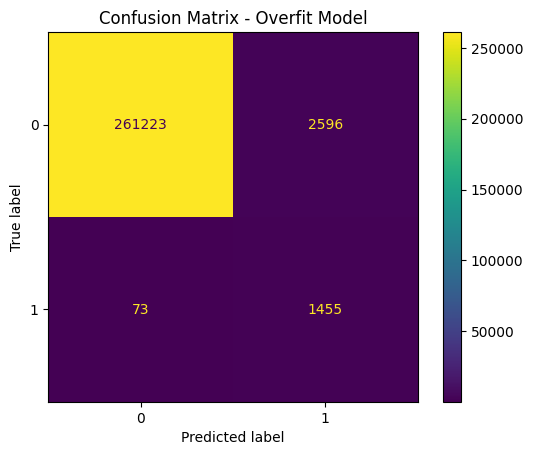

Overfit model training complete.


In [14]:
y_pred_overfit = score_balanced_model.predict(holdout_X)
print('Model Classification Report on holdout:')
print(classification_report(holdout_y, y_pred_overfit))

cm_overfit = confusion_matrix(holdout_y, y_pred_overfit)
disp_overfit = ConfusionMatrixDisplay(cm_overfit)
disp_overfit.plot()
plt.title('Confusion Matrix - Overfit Model')
plt.show()
print("Overfit model training complete.")

In [7]:
# Load holdout and out-of-time datasets for evaluation
holdout = pd.read_parquet('../data/holdout_data.parquet')
oot = pd.read_parquet('../data/oot_data.parquet')

# Prepare feature sets for evaluation
holdout_X = holdout.drop(columns=['is_fraud'] + metadata_columns)[train_X.columns]
holdout_y = holdout['is_fraud']

oot_X = oot.drop(columns=['is_fraud'] + metadata_columns)[train_X.columns]
oot_y = oot['is_fraud']

In [8]:
# Initialize evaluation classes
report_class = ModelPerformanceReport(train_X, train_y, holdout_X, holdout_y, oot_X, oot_y)
eval_plots = EvalPlots()

In [9]:
report_class.produce_report(score_balanced_model)

,train,holdout,oot
accuracy,0.990382,0.989941,0.989630
precision,0.371188,0.359171,0.259813
recall,0.965963,0.952225,0.924453
f1,0.536295,0.521599,0.405626


In [10]:
# Generate predictions for all datasets
y_train_pred, y_train_true, y_holdout_pred, y_holdout_true, y_oot_true, y_oot_pred = report_class.predictions(score_balanced_model)

In [11]:
# Generate and display evaluation plots
report_class.plot_eval_pred_dist(y_train_true, y_train_pred, y_holdout_true, y_holdout_pred, y_oot_true, y_oot_pred)

In [12]:
# Generate precision-recall AUC report
report_class.produce_pr_auc_report(score_balanced_model)

## 🔍 Model Performance Analysis

Evaluating the balanced model's performance across different datasets.

### Key Metrics:
- Prediction distributions
- Precision-Recall curves
- ROC curves
- Performance across datasets

## 📊 Performance Comparison

Comparing the balanced model's performance with the baseline model.

### Key Observations:
- Improved minority class detection
- Balanced performance metrics
- Reduced overfitting
- Better generalization


This second model performs better than the previos one. However, it still show lack of generalization.
Summing up the points from previous run, we can discover:
1. Parameter tuning
2. New features

The next notebook presents the state of the art method for fraud, with undersampling in each CV iteration